In [1]:
import os
import librosa
from IPython.display import Audio
os.environ['CUDA_VISIBLE_DEVICES'] = '0' 
import torch
import torchaudio

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

## Tency song

In [12]:
guitar_path = '/speech/dbwork/mul/spielwiese3/deuhlics/tency_writeout_20230710/tency1_10instr_dblbass2uprbass/part1/alice-cooper_poison_13025/guitar.flac'
bass_path = '/speech/dbwork/mul/spielwiese3/deuhlics/tency_writeout_20230710/tency1_10instr_dblbass2uprbass/part1/alice-cooper_poison_13025/bass.flac'
drums_path = '/speech/dbwork/mul/spielwiese3/deuhlics/tency_writeout_20230710/tency1_10instr_dblbass2uprbass/part1/alice-cooper_poison_13025/drums.flac'
vocal_path = '/speech/dbwork/mul/spielwiese3/deuhlics/tency_writeout_20230710/tency1_10instr_dblbass2uprbass/part1/alice-cooper_poison_13025/vocals.flac'
other_path = '/speech/dbwork/mul/spielwiese3/deuhlics/tency_writeout_20230710/tency1_10instr_dblbass2uprbass/part1/alice-cooper_poison_13025/other.flac'

## MusDB song

In [5]:
bass_path = '/speech/dbwork/mul/spielwiese4/students/demancum/musdb18hq/test/Al James - Schoolboy Facination/bass.wav'
drums_path = '/speech/dbwork/mul/spielwiese4/students/demancum/musdb18hq/test/Al James - Schoolboy Facination/drums.wav'
vocal_path = '/speech/dbwork/mul/spielwiese4/students/demancum/musdb18hq/test/Al James - Schoolboy Facination/vocals.wav'
other_path = '/speech/dbwork/mul/spielwiese4/students/demancum/musdb18hq/test/Al James - Schoolboy Facination/other.wav'

## MoisesDB song

In [3]:
bass_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/bass'
drums_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/drums'
vocal_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/vocals'
guitar_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/guitar'

## MoisesDB preprocessed and load

In [4]:
import os
import torch
import torchaudio

target_sr = 16000

# Function to load and preprocess audio
def load_audio(path, target_sr):
    # Load audio
    waveform, sample_rate = torchaudio.load(path)
    
    # Resample if necessary
    if sample_rate != target_sr:
        resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=target_sr)
        waveform = resampler(waveform)
    
    # Convert to mono if necessary
    if waveform.shape[0] > 1:
        waveform = torch.mean(waveform, dim=0)
    else:
        waveform = waveform.squeeze()
    
    return waveform

# Function to load and sum all audio files in a folder
def load_and_sum_audios_in_folder(folder_path, target_sr):
    # List all WAV files in the folder
    wav_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith('.wav')]
    
    waveforms = []
    max_length = 0
    
    # Load and process each WAV file
    for wav_file in wav_files:
        waveform = load_audio(wav_file, target_sr)
        waveforms.append(waveform)
        # Keep track of the maximum length
        if waveform.shape[0] > max_length:
            max_length = waveform.shape[0]
    
    # Pad all waveforms to the maximum length
    padded_waveforms = []
    for waveform in waveforms:
        padding = max_length - waveform.shape[0]
        if padding > 0:
            # Pad the waveform at the end with zeros
            waveform = torch.nn.functional.pad(waveform, (0, padding))
        padded_waveforms.append(waveform)
    
    # Sum all the padded waveforms
    summed_waveform = torch.stack(padded_waveforms).sum(dim=0)
    
    return summed_waveform

# Paths to your folders
bass_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/bass'
drums_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/drums'
vocal_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/vocals'
guitar_path = '/speech/dbwork/mul/spielwiese4/students/demancum/moisesdb/moisesdb/moisesdb_v0.1/6681f493-c996-424a-9bdb-c671912ea9db/guitar'

# Process each folder
bass_data = load_and_sum_audios_in_folder(bass_path, target_sr)
drums_data = load_and_sum_audios_in_folder(drums_path, target_sr)
vocal_data = load_and_sum_audios_in_folder(vocal_path, target_sr)
guitar_data = load_and_sum_audios_in_folder(guitar_path, target_sr)

# Ensure all audio arrays are the same length
min_length = min(
    #len(guitar_data), 
    len(bass_data), 
    len(drums_data), 
    len(vocal_data), 
    len(guitar_data)
)

#guitar_data = guitar_data[:min_length]
bass_data = bass_data[:min_length]
drums_data = drums_data[:min_length]
vocal_data = vocal_data[:min_length]
other_data = other_data[:min_length]


print(bass_data.shape, drums_data.shape, vocal_data.shape, guitar_data.shape)

mix = bass_data + drums_data + vocal_data + guitar_data


torch.Size([4672000]) torch.Size([4672000]) torch.Size([4672000]) torch.Size([4672000])


In [5]:
# Play the mix
print("Mix:")
Audio(data=mix, rate=target_sr)

Mix:


## Normal preprocessed and load

In [6]:
import torchaudio
import torch

# Target sampling rate
target_sr = 16000

# Function to load and preprocess audio
def load_audio(path, target_sr):
    # Load audio
    waveform, sample_rate = torchaudio.load(path)
    
    # Resample if necessary
    if sample_rate != target_sr:
        resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=target_sr)
        waveform = resampler(waveform)
    
    # Convert to mono if necessary
    if waveform.shape[0] > 1:
        waveform = torch.mean(waveform, dim=0)
    else:
        waveform = waveform.squeeze()
    
    return waveform

# Load guitar
#guitar_data = load_audio(guitar_path, target_sr)

# Load bass
bass_data = load_audio(bass_path, target_sr)

# Load drums
drums_data = load_audio(drums_path, target_sr)

# Load vocal
vocal_data = load_audio(vocal_path, target_sr)

# Load other
other_data = load_audio(other_path, target_sr)

# Ensure all audio arrays are the same length
min_length = min(
    #len(guitar_data), 
    len(bass_data), 
    len(drums_data), 
    len(vocal_data), 
    len(other_data)
)

#guitar_data = guitar_data[:min_length]
bass_data = bass_data[:min_length]
drums_data = drums_data[:min_length]
vocal_data = vocal_data[:min_length]
other_data = other_data[:min_length]


In [6]:
from contrastive_model import constants
from contrastive_model.contrastive_model import CoCola
from feature_extraction.feature_extraction import CoColaFeatureExtractor


model = CoCola.load_from_checkpoint("/home/demancum/cocola_test/checkpoint-epoch=119-val_loss=0.00.ckpt")
model.to(device)
feature_extractor = CoColaFeatureExtractor()
feature_extractor.to(device)

model.eval()

# Set to:
# - constants.EmbeddingMode.BOTH for standard COCOLA Score
# - constants.EmbeddingMode.HARMONIC for COCOLA Harmonic Score
# - constants.EmbeddingMode.PERCUSSIVE for COCOLA Percussive Score
model.set_embedding_mode(constants.EmbeddingMode.BOTH)
# Sum the audio data to mix the tracks
mix = bass_data + guitar_data + vocal_data + other_data + drums_data 
stem = bass_data + guitar_data #bass_data + vocal_data + other_data + drums_data 

In [7]:
# Play the mix
print("Mix:")
Audio(data=mix, rate=target_sr)

Mix:


In [8]:
# Play the guitar stem
print("Stem:")
Audio(data=stem, rate=target_sr)

Stem:


In [9]:
import torch

def is_silent(window, threshold=1e-2):
    rms = torch.sqrt(torch.mean(window ** 2))
    return rms < threshold


Processing:   0%|          | 0/58 [00:00<?, ?it/s]/tmp/ipykernel_3449278/3551836165.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mix_tensor = torch.tensor(mix_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
/tmp/ipykernel_3449278/3551836165.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  stem_tensor = torch.tensor(stem_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
Processing:   2%|▏         | 1/58 [00:03<03:26,  3.63s/it]/tmp/ipykernel_3449278/3551836165.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tenso

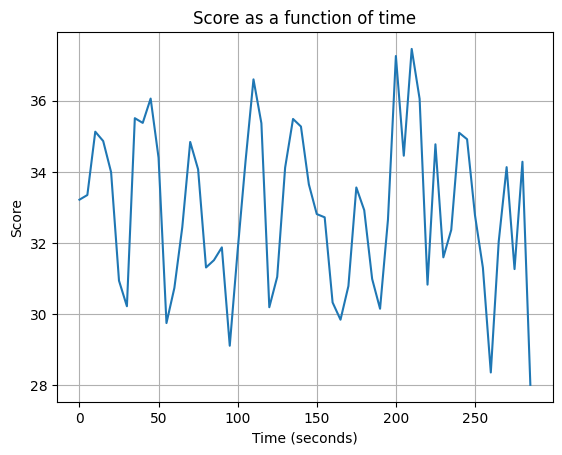

In [10]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm  # Import tqdm for the progress bar

# Supponiamo che la frequenza di campionamento sia 16kHz
sample_rate = 16000  # 16kHz
window_duration = 5  # 5 secondi
hop_duration = 5    # 1 secondo

# Convertiamo le durate in numero di campioni
window_size = int(window_duration * sample_rate)  # 80000 campioni
hop_size = int(hop_duration * sample_rate)        # 16000 campioni

# Lista per tenere traccia degli score e dei tempi corrispondenti
scores = []
times = []

# Calcolare il numero di iterazioni per il progress bar
num_iterations = (len(mix) - window_size) // hop_size + 1

# Mettiamo il modello in modalità di valutazione e disabilitiamo la computazione dei gradienti
model.eval()
with torch.no_grad():
    for i in tqdm(range(0, len(mix) - window_size, hop_size), total=num_iterations, desc="Processing"):
        # Extract windows
        mix_window = mix[i:i+window_size]
        stem_window = stem[i:i+window_size]

        # Check for silence in both windows
        if is_silent(mix_window) and is_silent(stem_window):
            continue  # Skip processing this window

        # Prepare tensors
        mix_tensor = torch.tensor(mix_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
        stem_tensor = torch.tensor(stem_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)

        # Feature extraction
        features_x = feature_extractor(mix_tensor)
        features_y = feature_extractor(stem_tensor)

        # Compute score
        score = model.score(features_x.to(device), features_y.to(device))

        # Append results
        scores.append(score.item())
        times.append(i / sample_rate)

# Plot del grafico
plt.plot(times, scores)
plt.xlabel("Time (seconds)")
plt.ylabel("Score")
plt.title("Score as a function of time")
plt.grid(True)
plt.show()


In [11]:
import numpy as np
from IPython.display import Audio

# Assuming 'scores' and 'times' have been computed from your previous code

# Convert the list of scores to a NumPy array for easy manipulation
scores_array = np.array(scores)

# Find the indices of the two lowest scores
lowest_indices = np.argsort(scores_array)[:2]  # This returns the indices of the smallest scores

print("Indices of the two lowest scores:", lowest_indices)
print("Corresponding lowest scores:", scores_array[lowest_indices])

# For each of the lowest score indices, extract and play the audio segments
for idx in lowest_indices:
    # Calculate the start and end sample indices for the window
    start_sample = int(times[idx] * sample_rate)
    end_sample = start_sample + window_size

    # Extract the audio segments from the mix and stem
    mix_segment = mix[start_sample:end_sample]
    stem_segment = stem[start_sample:end_sample]

    # Print the time range of the segment
    print(f"\nPlaying segment {idx + 1} with lowest score:")
    print(f"Time range: {times[idx]}s to {times[idx] + window_duration}s")
    print(f"Score: {scores_array[idx]}")

    # Play the mix segment
    print("Mix Segment:")
    display(Audio(data=mix_segment, rate=sample_rate))

    # Play the stem segment
    print("Stem Segment:")
    display(Audio(data=stem_segment, rate=sample_rate))


Indices of the two lowest scores: [57 52]
Corresponding lowest scores: [28.00208664 28.35230064]

Playing segment 58 with lowest score:
Time range: 285.0s to 290.0s
Score: 28.002086639404297
Mix Segment:


Stem Segment:



Playing segment 53 with lowest score:
Time range: 260.0s to 265.0s
Score: 28.3523006439209
Mix Segment:


Stem Segment:


In [ ]:
# Load the score matrix
#score_matrix = torch.load("/home/demancum/cocola_test/score_matrix.pt")
#print("Score matrix loaded successfully.")


In [12]:
# Parameters for windowing
sample_rate = target_sr  # 16kHz
window_duration = 10      # Window duration in seconds
hop_duration = 10         # Hop duration in seconds (no overlap)

# Convert durations to samples
window_size = int(window_duration * sample_rate)
hop_size = int(hop_duration * sample_rate)

# Calculate the number of windows
num_windows = (len(mix) - window_size) // hop_size + 1

# Initialize the score matrix
score_matrix = np.zeros((num_windows, num_windows))

# Loop over mix windows
print("Computing the score matrix...")
for i in tqdm(range(num_windows), desc="Processing mix windows"):
    # Extract mix window
    start_mix = i * hop_size
    mix_window = mix[start_mix:start_mix + window_size]
    
    # Convert to tensor and send to device
    mix_tensor = torch.tensor(mix_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
    
    # Extract features for the mix window
    features_x = feature_extractor(mix_tensor)
    
    # Loop over stem windows
    for j in range(num_windows):
        # Extract stem window
        start_stem = j * hop_size
        stem_window = stem[start_stem:start_stem + window_size]
        
        # Convert to tensor and send to device
        stem_tensor = torch.tensor(stem_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
        
        # Extract features for the stem window
        features_y = feature_extractor(stem_tensor)
        
        # Compute the score
        with torch.no_grad():
            score = model.score(features_x.to(device), features_y.to(device))
        
        # Store the score in the matrix
        score_matrix[i, j] = score.item()

# Define save path
save_path = "/home/demancum/cocola_test/score_matrix.pt"

# After computing the score matrix
torch.save(score_matrix, save_path)
print(f"Score matrix saved at {save_path}")


Computing the score matrix...


Processing mix windows:   0%|          | 0/29 [00:00<?, ?it/s]/tmp/ipykernel_3449278/2548246290.py:24: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mix_tensor = torch.tensor(mix_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
/tmp/ipykernel_3449278/2548246290.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  stem_tensor = torch.tensor(stem_window, dtype=torch.float32).unsqueeze(0).unsqueeze(1).to(device)
Processing mix windows: 100%|██████████| 29/29 [08:10<00:00, 16.92s/it]

Score matrix saved at /home/demancum/cocola_test/score_matrix.pt


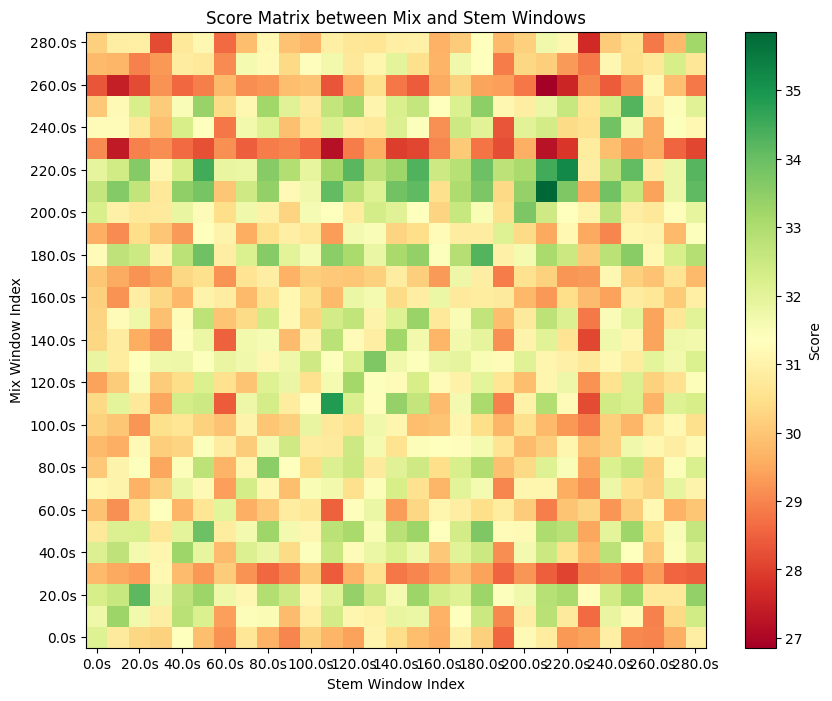

In [13]:
# Plotting the score matrix
plt.figure(figsize=(10, 8))
plt.imshow(score_matrix, aspect='auto', cmap='RdYlGn', origin='lower')

# Set axis labels and title
plt.colorbar(label='Score')
plt.xlabel('Stem Window Index')
plt.ylabel('Mix Window Index')
plt.title('Score Matrix between Mix and Stem Windows')

# Optionally, set custom ticks to represent time
times = [i * hop_duration for i in range(num_windows)]
plt.xticks(np.arange(0, num_windows, max(num_windows // 10, 1)), 
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])
plt.yticks(np.arange(0, num_windows, max(num_windows // 10, 1)), 
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])

plt.show()

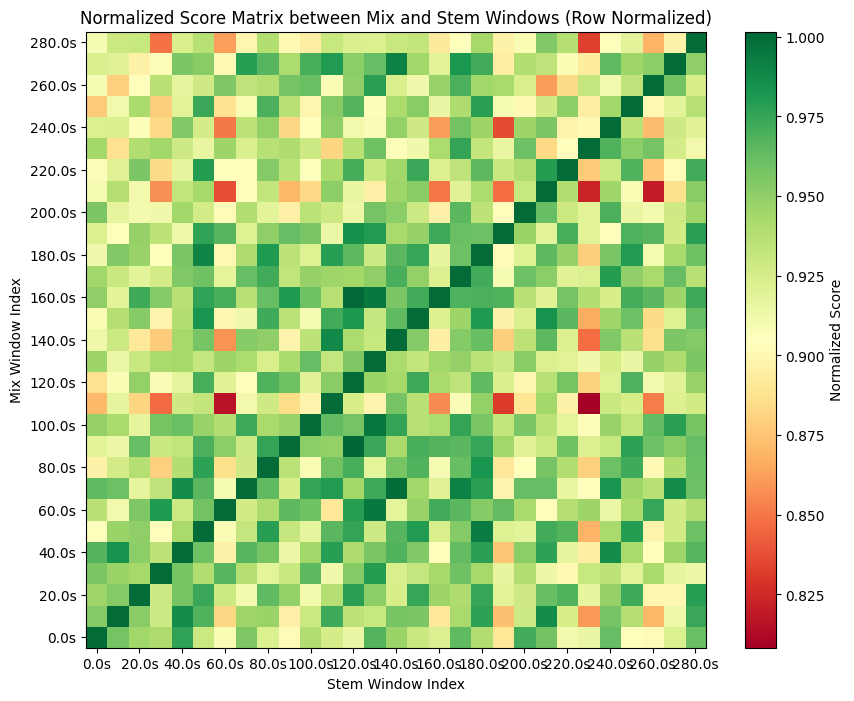

In [14]:

for i in range(num_windows):
    norm_factor = score_matrix[i, i]
    if norm_factor != 0:
        score_matrix[i, :] = score_matrix[i, :] / norm_factor
    else:
        score_matrix[i, :] = 0  # Or handle as appropriate

# Plotting the normalized score matrix
plt.figure(figsize=(10, 8))
plt.imshow(score_matrix, aspect='auto', cmap='RdYlGn', origin='lower')

# Set axis labels and title
plt.colorbar(label='Normalized Score')
plt.xlabel('Stem Window Index')
plt.ylabel('Mix Window Index')
plt.title('Normalized Score Matrix between Mix and Stem Windows (Row Normalized)')

# Optionally, set custom ticks to represent time
times = [i * hop_duration for i in range(num_windows)]
plt.xticks(np.arange(0, num_windows, max(num_windows // 10, 1)),
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])
plt.yticks(np.arange(0, num_windows, max(num_windows // 10, 1)),
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])

plt.show()


TypeError: Invalid shape () for image data

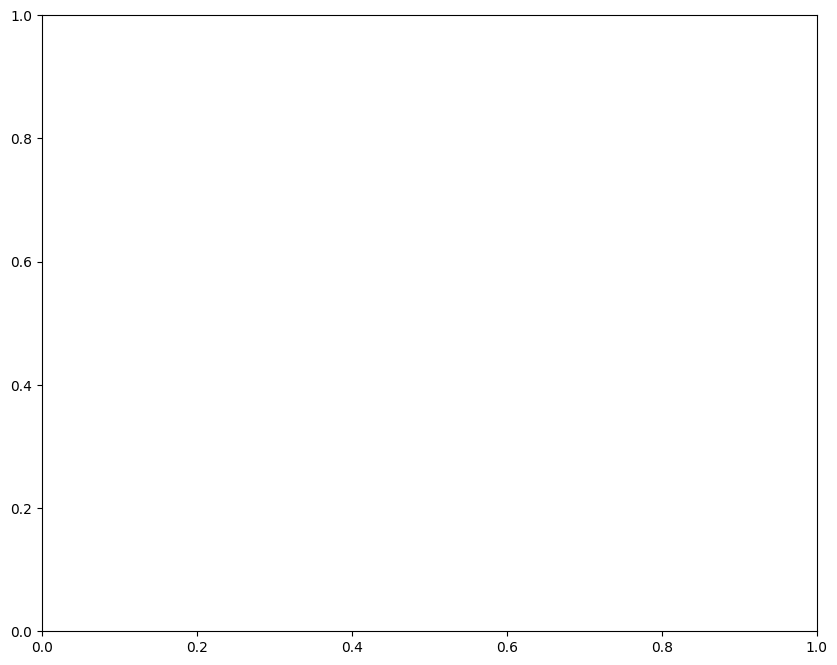

In [22]:
# Plotting the score matrix
plt.figure(figsize=(10, 8))
plt.imshow(score_matrix, aspect='auto', cmap='RdYlGn', origin='lower')

# Set axis labels and title
plt.colorbar(label='Score')
plt.xlabel('Stem Window Index')
plt.ylabel('Mix Window Index')
plt.title('Score Matrix between Mix and Stem Windows')

# Optionally, set custom ticks to represent time
times = [i * hop_duration for i in range(num_windows)]
plt.xticks(np.arange(0, num_windows, max(num_windows // 10, 1)), 
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])
plt.yticks(np.arange(0, num_windows, max(num_windows // 10, 1)), 
           [f"{t:.1f}s" for t in times[::max(num_windows // 10, 1)]])

plt.show()

## Silence filtered out?

In [34]:
import numpy as np
from tqdm import tqdm

# Parameters for windowing
sample_rate = target_sr  # 16kHz
window_duration = 10      # Window duration in seconds
hop_duration = 10         # Hop duration in seconds (no overlap)

# Convert durations to samples
window_size = int(window_duration * sample_rate)
hop_size = int(hop_duration * sample_rate)

# Calculate the number of windows
num_windows = (len(mix) - window_size) // hop_size + 1

# Initialize the score matrix with NaNs
score_matrix = np.full((num_windows, num_windows), np.nan)

# Loop over mix windows
print("Computing the score matrix...")
for i in tqdm(range(num_windows), desc="Processing mix windows"):
    # Extract mix window
    start_mix = i * hop_size
    mix_window = mix[start_mix:start_mix + window_size]
    
    # Convert mix window to tensor
    mix_window_tensor = torch.tensor(mix_window, dtype=torch.float32)
    
    # Check if mix window is silent
    if is_silent(mix_window_tensor):
        continue  # Skip processing this mix window
    
    # Convert to tensor and send to device
    mix_tensor = mix_window_tensor.unsqueeze(0).unsqueeze(1).to(device)
    
    # Extract features for the mix window
    features_x = feature_extractor(mix_tensor)
    
    # Loop over stem windows
    for j in range(num_windows):
        # Extract stem window
        start_stem = j * hop_size
        stem_window = stem[start_stem:start_stem + window_size]
        
        # Convert stem window to tensor
        stem_window_tensor = torch.tensor(stem_window, dtype=torch.float32)
        
        # Check if stem window is silent
        if is_silent(stem_window_tensor):
            continue  # Skip processing this stem window
        
        # Convert to tensor and send to device
        stem_tensor = stem_window_tensor.unsqueeze(0).unsqueeze(1).to(device)
        
        # Extract features for the stem window
        features_y = feature_extractor(stem_tensor)
        
        # Compute the score
        with torch.no_grad():
            score = model.score(features_x.to(device), features_y.to(device))
        
        # Store the score in the matrix
        score_matrix[i, j] = score.item()




Computing the score matrix...


Processing mix windows:   0%|          | 0/27 [00:00<?, ?it/s]/tmp/ipykernel_2541295/1325766951.py:27: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mix_window_tensor = torch.tensor(mix_window, dtype=torch.float32)
/tmp/ipykernel_2541295/1325766951.py:46: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  stem_window_tensor = torch.tensor(stem_window, dtype=torch.float32)
Processing mix windows: 100%|██████████| 27/27 [12:58<00:00, 28.82s/it]


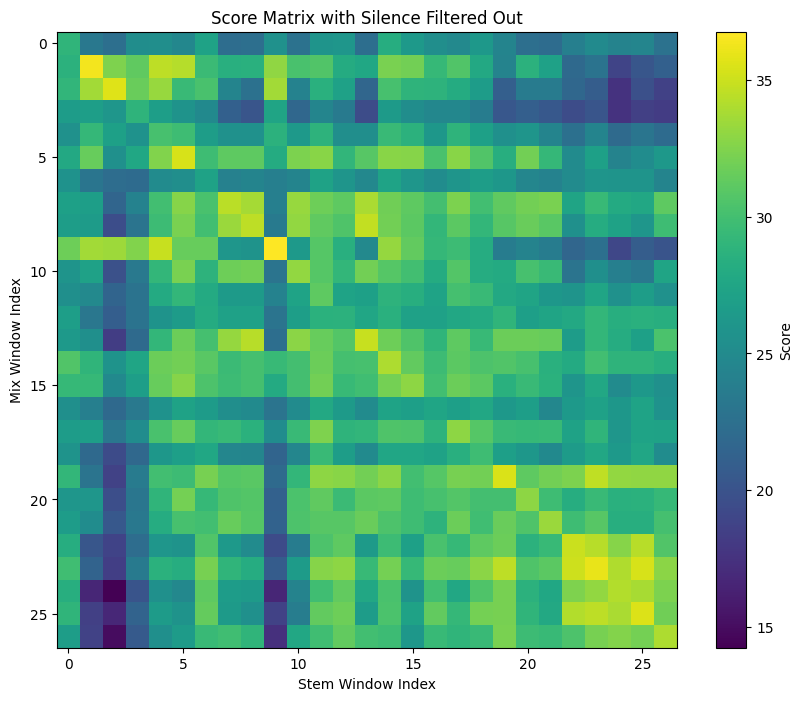

In [35]:
import matplotlib.pyplot as plt

# Create a colormap that maps NaNs to black
cmap = plt.cm.viridis.copy()
cmap.set_bad(color='black')

# Plot the score matrix
plt.figure(figsize=(10, 8))
plt.imshow(score_matrix, interpolation='none', aspect='auto', cmap=cmap)
plt.colorbar(label='Score')
plt.xlabel('Stem Window Index')
plt.ylabel('Mix Window Index')
plt.title('Score Matrix with Silence Filtered Out')
plt.show()
